# Olist E-Commerce Avaliation

In [144]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [145]:
import pandas as pd
import numpy as np
import seaborn as sns
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import babel.numbers
import decimal
import geopandas as gpd

## How could Olist improve its profit?

### Assuming the following:

#### Revenues  
**Sales fees:** Olist takes a **10% cut** on the product price (excl. freight) of each order delivered  
**Subscription fees:** Olist charges **80 BRL by month** per seller

#### Costs
**Reputation costs** *estimated* per order with bad reviews (<= 3 stars)  

💡 In the long term, bad customer experience has business implications: low repeat rate, immediate customer support cost, refunds or unfavorable word of mouth communication. We will assume that we have an estimate measure of the monetary cost for each bad review:
```python
# review_score: cost(BRL)
{'1 star': 100
'2 stars': 50
'3 stars': 40
'4 stars': 0
'5 stars': 0}
```

**IT costs:** Olist's **total cumulated IT Costs** scale with the square root of the total number of sellers that has ever join the platform, as well as the square root of the total cumulated number of products that was ever sold.  

$IT\_costs = \alpha * \sqrt{n\_sellers} + \beta * \sqrt{n\_products}$  
Olist's data team gave us the following values for these scaling parameters:
- $\alpha = 3157.27$
- $\beta = 978.23$

💡 Both number of sellers to manage and sales transaction are costly for IT systems.  
💡 Yet square roots reflect scale-effects: IT-system are often more efficient as they grow bigger.  
💡 Alpha > Beta means that "Olist has a lower IT Cost with few sellers selling a lot of products rather than the opposite  
- with **1000 sellers** and a total of **100 products** sold, the total IT cost accumulates to 109,624 BRL
- with **100 sellers** and a total of **1000 products** sold, the total IT cost accumulates to 62,507 BRL

Finally, The IT department also told you that since the birth of the marketplace, cumulated IT costs have amounted to **500,000 BRL**.

## 2. Should Olist remove under-performing sellers from its marketplace?

## Data Analysis

In [146]:
from olist.seller import Seller
sellers = Seller().get_training_data()
sellers

,seller_id,seller_city,seller_state,delay_to_carrier,wait_time,date_first_sale,date_last_sale,months_on_olist,n_orders,quantity,quantity_per_order,sales,share_of_five_stars,share_of_one_stars,review_score,cost_of_reviews,revenues,profits
0,3442f8959a84dea7ee197c632cb2df15,campinas,SP,0.000000,13.018588,2017-05-05 16:25:11,2017-08-30 12:50:19,4.0,3,3,1.000000,218.70,0.333333,0.333333,3.000000,140,341.870,201.870
1,d1b65fc7debc3361ea86b5f14c68d2e2,mogi guacu,SP,0.000000,9.065716,2017-03-29 02:10:34,2018-06-06 20:15:21,14.0,40,41,1.025000,11703.07,0.731707,0.048780,4.560976,240,2290.307,2050.307
2,ce3ad9de960102d0677a81f5d0bb7b2d,rio de janeiro,RJ,0.000000,4.042292,2018-07-30 12:44:49,2018-07-30 12:44:49,0.0,1,1,1.000000,158.00,1.000000,0.000000,5.000000,0,15.800,15.800
3,c0f3eea2e14555b6faeea3dd58c1b1c3,sao paulo,SP,0.000000,5.667187,2018-08-03 00:44:08,2018-08-03 00:44:08,0.0,1,1,1.000000,79.99,1.000000,0.000000,5.000000,0,7.999,7.999
4,51a04a8a6bdcb23deccc82b0b80742cf,braganca paulista,SP,3.353727,35.314861,2017-11-14 12:15:25,2017-11-14 12:15:25,0.0,1,1,1.000000,167.99,0.000000,1.000000,1.000000,100,16.799,-83.201
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2962,98dddbc4601dd4443ca174359b237166,sarandi,PR,0.000000,8.230822,2018-07-14 03:10:19,2018-07-23 15:34:03,0.0,2,2,1.000000,158.00,1.000000,0.000000,5.000000,0,15.800,15.800
2963,f8201cab383e484733266d1906e2fdfa,palhoca,SC,0.000000,13.045797,2017-06-17 15:30:11,2018-08-11 19:55:17,14.0,10,10,1.000000,889.00,0.500000,0.100000,4.100000,140,1208.900,1068.900
2964,74871d19219c7d518d0090283e03c137,sao paulo,SP,0.000000,3.606625,2018-04-05 17:09:46,2018-08-21 19:25:15,5.0,6,7,1.166667,550.04,1.000000,0.000000,5.000000,0,455.004,455.004
2965,e603cf3fec55f8697c9059638d6c8eb5,pelotas,RS,0.000000,6.657634,2017-02-09 02:43:17,2017-06-16 17:30:16,4.0,8,11,1.375000,297.00,0.636364,0.000000,4.454545,50,349.700,299.700


## Sellers table Sample

In [147]:
sellers = sellers[['seller_id','seller_state','months_on_olist', 'quantity','sales','cost_of_reviews', 'revenues','profits']].sort_values('profits')
sellers[['seller_state','months_on_olist', 'quantity','sales','cost_of_reviews', 'revenues','profits']].sample(5)

,seller_state,months_on_olist,quantity,sales,cost_of_reviews,revenues,profits
196,SP,16.0,43,3955.7,550,1675.57,1125.57
2716,MG,6.0,2,51.9,100,485.19,385.19
1032,SP,1.0,14,1134.6,100,193.46,93.46
1644,SP,4.0,30,4661.0,740,786.10,46.10
1010,PR,3.0,3,309.7,0,270.97,270.97


In [148]:
alpha = 3157.27
beta = 978.23
# cumulated_costs = 500000 the same of IT_costs
IT_costs = alpha*np.sqrt(sellers['seller_id'].count()) + beta*np.sqrt(sellers['quantity'].sum())
Olist_total_cost = IT_costs + sellers["cost_of_reviews"].sum()
Olist_revenue = sellers['revenues'].sum()
Olist_global_profit = Olist_revenue - Olist_total_cost
# Print the first results
# print(f'Total Cost: {Olist_total_cost}')
# print(f'Revenue: {Olist_revenue}')
# print(f'Global Profit: BRL {int(Olist_global_profit)}')

# Print the first results

tc = babel.numbers.format_currency(decimal.Decimal( f"{Olist_total_cost}" ), "BRL" )
r = babel.numbers.format_currency(decimal.Decimal( f"{Olist_revenue}" ), "BRL" )
gp = babel.numbers.format_currency(decimal.Decimal( f"{Olist_global_profit}" ), "BRL" )
print(f'Total Cost: {tc}')
print(f'Revenue: {r}')
print(f'Global Profit: {gp}')



Total Cost: R$2,476,649.32
Revenue: R$2,785,818.44
Global Profit: R$309,169.13


In [149]:
def impact_sellers(df):
    impact = sellers
    impact['Total_Cost'] = [
        alpha*np.sqrt(df['seller_id'].iloc[i:].count()) + 
        beta*np.sqrt(df['quantity'].iloc[i:].sum()) +
        df["cost_of_reviews"].iloc[i:].sum() for i in range(len(df))]
    impact['Revenue'] = [df['revenues'].iloc[i:].sum()for i in range(len(df))]
    impact['Global_profit'] = impact['Revenue'] - impact['Total_Cost']
    impact['amount_sellers'] = [i for i in range(len(df)-1, -1, -1)]
    return impact

### Is it possible to increase the profit removing from our database sellers which does not return profit?

We want to find:
- Good Sellers: Seller which return profit
- Median Sellers: Seller which could return or not profit
- Bad Sellers: Seller which not return profit
    

In [150]:
total = impact_sellers(sellers).drop('seller_id', axis=1)
total[['seller_state','cost_of_reviews', 'revenues','profits','Revenue','Global_profit','amount_sellers']].head()

,seller_state,cost_of_reviews,revenues,profits,Revenue,Global_profit,amount_sellers
769,SP,40120,13770.483,-26349.517,2785818.444,309169.125481,2966
453,SP,37490,12053.921,-25436.079,2772047.961,338526.571883,2965
1132,SP,44290,20232.389,-24057.611,2759994.040,366846.629107,2964
2358,SP,44620,21647.292,-22972.708,2739761.651,392965.255081,2963
1357,SP,31070,11948.842,-19121.158,2718114.359,418950.392911,2962


In [151]:
max_profit_point = total['amount_sellers'].loc[total['Global_profit'].idxmax()]
max_profit_point # index 2011

negative_sellers = total[total['profits'] <= 0]
tmp = total[total['profits'] > 0]
positive_sellers = tmp[tmp['amount_sellers'] <= max_profit_point]
positive_median = tmp[tmp['amount_sellers'] > max_profit_point]

In [152]:
sellers_type = {
    'positive': positive_sellers['amount_sellers'].count(),
    'positive_median': positive_median['amount_sellers'].count(),
    'negative': negative_sellers['amount_sellers'].count()
}
sellers_type

{'positive': 2012, 'positive_median': 463, 'negative': 492}

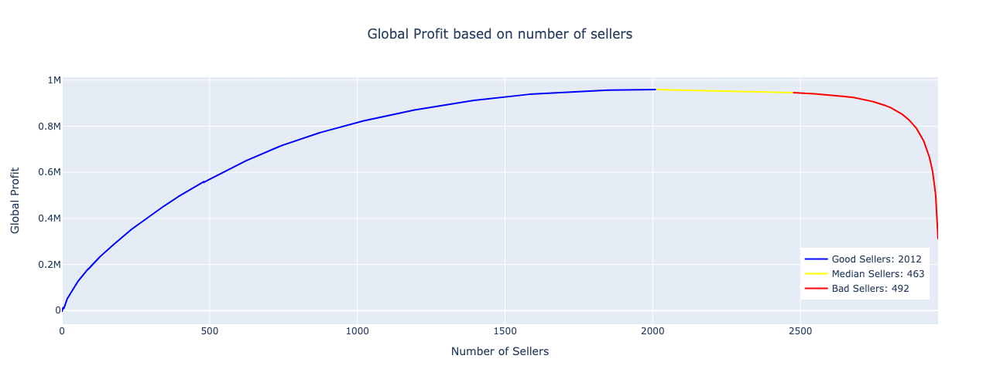

In [153]:
fig = go.Figure(data=go.Scatter(x=positive_sellers['amount_sellers'], y=positive_sellers['Global_profit'],
                               marker=dict(color="blue"), name=f"Good Sellers: {sellers_type['positive']}"))

fig.add_trace(go.Scatter(x=positive_median['amount_sellers'], y=positive_median['Global_profit'],
                         marker=dict(color="yellow"), name=f"Median Sellers: {sellers_type['positive_median']}"))

fig.add_trace(go.Scatter(x=negative_sellers['amount_sellers'], y=negative_sellers['Global_profit'],
                         marker=dict(color="red"), name=f"Bad Sellers: {sellers_type['negative']}"))
fig.update_layout(legend=dict(yanchor="bottom",y=0.1,xanchor="right",x=0.99), xaxis=dict(title=dict(text="Number of Sellers")), 
                  yaxis=dict(title=dict(text="Global Profit")), width=1000, height=500,
                 title='Global Profit based on number of sellers',title_x=0.5)

fig.show()

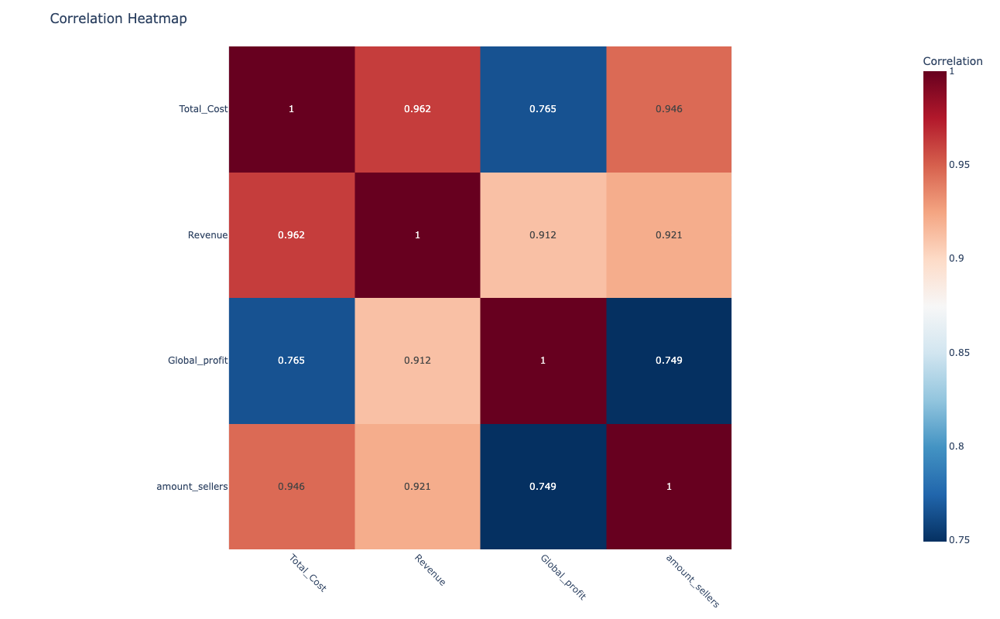

In [154]:
corr_matrix = total[['Total_Cost','Revenue','Global_profit','amount_sellers']].corr().round(3)

fig = px.imshow(
    corr_matrix,
    text_auto=True,  # Display correlation values in the cells
    color_continuous_scale='RdBu_r',  # Color scale
    width=900, height=800
)

fig.update_layout(
    title='Correlation Heatmap',
    coloraxis_colorbar=dict(title='Correlation'),
    xaxis=dict(tickangle=45),
    yaxis=dict(tickangle=0),
)

fig.show()

### Analysing Sellers

In [155]:
norm_positive = positive_sellers.groupby('seller_state', as_index=False).mean()
norm_median = positive_median.groupby('seller_state', as_index=False).mean()
norm_negative = negative_sellers.groupby('seller_state', as_index=False).mean()

#### Bad Sellers (492)

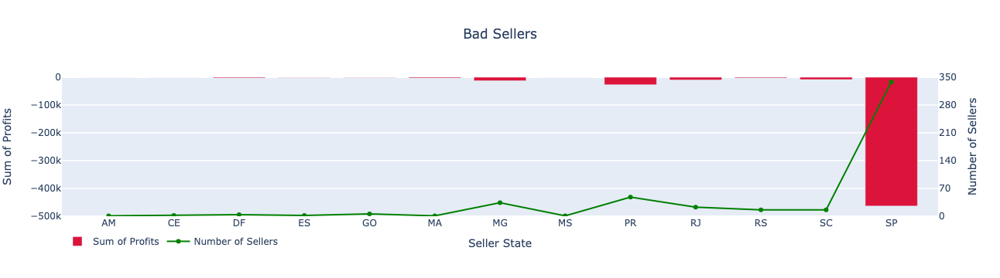

In [156]:
count_n = negative_sellers.groupby('seller_state', as_index=False).count()
sum_n = negative_sellers.groupby('seller_state', as_index=False).sum()
fig = go.Figure(data=go.Bar(x=sum_n['seller_state'], y=sum_n['profits'], name="Sum of Profits",
                            marker=dict(color="crimson")))
fig.add_trace(go.Scatter(x=count_n['seller_state'], y=count_n['amount_sellers'], yaxis="y2",name="Number of Sellers",
                         marker=dict(color="green")))
fig.update_layout(legend=dict(orientation="h"), xaxis=dict(title=dict(text="Seller State")), yaxis=dict(title=dict(text="Sum of Profits"), side="left", dtick=100000, range=[-500000,0]),
    yaxis2=dict(title=dict(text="Number of Sellers"),side="right",overlaying="y", dtick=70 , range=[0,350]),title='Bad Sellers',title_x=0.5)
fig.show()

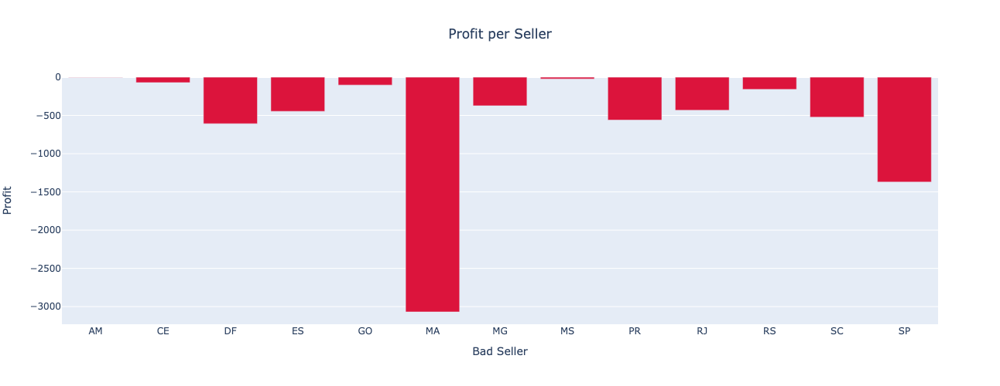

In [157]:
fig = go.Figure(data=go.Bar(x=norm_negative['seller_state'], y=norm_negative['profits'], name="Profit per Seller",
                            marker=dict(color="crimson")))
fig.update_layout(legend=dict(yanchor="bottom",y=0.1,xanchor="right",x=0.99), xaxis=dict(title=dict(text="Bad Seller")),
                  yaxis=dict(title=dict(text="Profit")), width=1000, height=500, title='Profit per Seller',title_x=0.5)
fig.show()

#### Median Sellers (463)

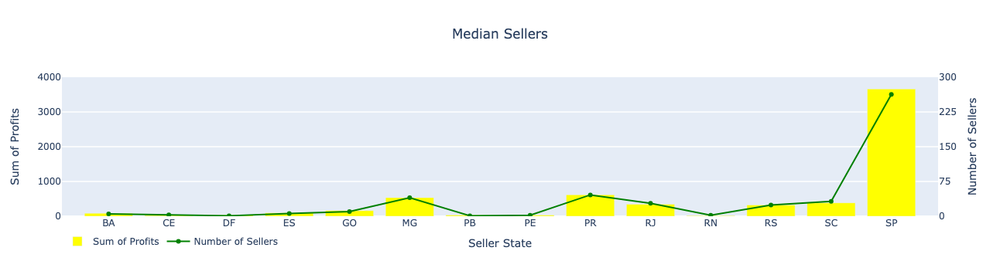

In [158]:
count_pm = positive_median.groupby('seller_state', as_index=False).count()
sum_pm = positive_median.groupby('seller_state', as_index=False).sum()
fig = go.Figure(data=go.Bar(x=sum_pm['seller_state'], y=sum_pm['profits'], name="Sum of Profits",
                            marker=dict(color="yellow")))
fig.add_trace(go.Scatter(x=count_pm['seller_state'], y=count_pm['amount_sellers'], yaxis="y2",name="Number of Sellers",
                         marker=dict(color="green")))
fig.update_layout(legend=dict(orientation="h"), xaxis=dict(title=dict(text="Seller State")), yaxis=dict(title=dict(text="Sum of Profits"), side="left", dtick=1000, range=[0,4000]),
    yaxis2=dict(title=dict(text="Number of Sellers"),side="right",overlaying="y", dtick=75 , range=[0,300]), title='Median Sellers',title_x=0.5)
fig.show()

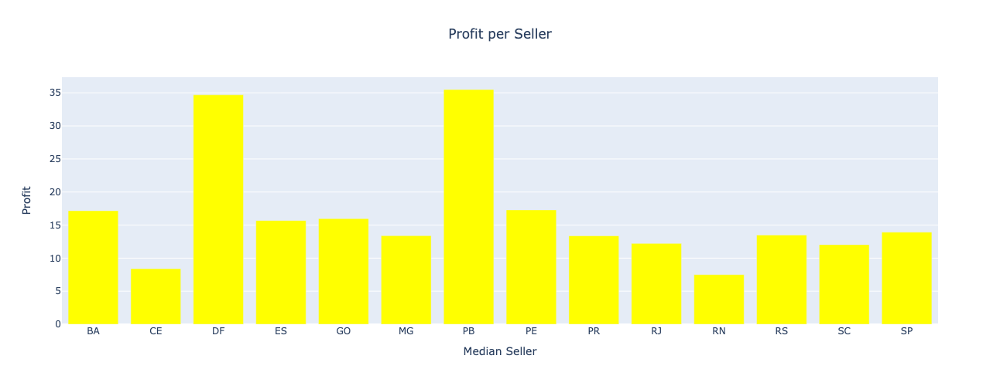

In [159]:
fig = go.Figure(data=go.Bar(x=norm_median['seller_state'], y=norm_median['profits'], name="Profit per Seller",
                            marker=dict(color="yellow")))
fig.update_layout(legend=dict(yanchor="bottom",y=0.1,xanchor="right",x=0.99), xaxis=dict(title=dict(text="Median Seller")),
                  yaxis=dict(title=dict(text="Profit")), width=1000, height=500, title='Profit per Seller',title_x=0.5)
fig.show()

#### Good Sellers (2012)

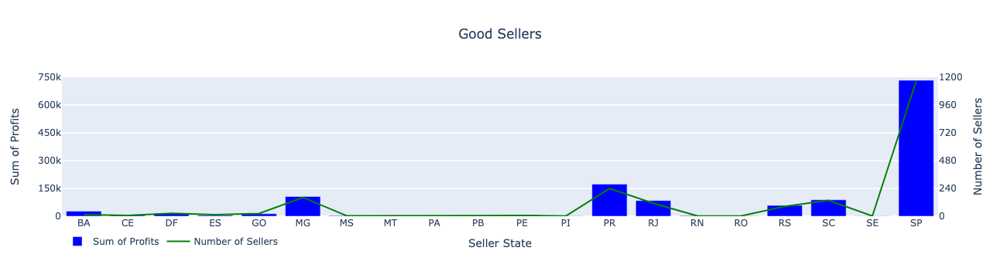

In [160]:
count_p = positive_sellers.groupby('seller_state', as_index=False).count()
sum_p = positive_sellers.groupby('seller_state', as_index=False).sum()
fig = go.Figure(data=go.Bar(x=sum_p['seller_state'], y=sum_p['profits'], name="Sum of Profits",
                            marker=dict(color="blue")))
fig.add_trace(go.Scatter(x=count_p['seller_state'], y=count_p['amount_sellers'], yaxis="y2",name="Number of Sellers",
                         marker=dict(color="green")))
fig.update_layout(legend=dict(orientation="h"), xaxis=dict(title=dict(text="Seller State")), yaxis=dict(title=dict(text="Sum of Profits"), side="left", dtick=150000, range=[0, 750000]),
    yaxis2=dict(title=dict(text="Number of Sellers"),side="right",overlaying="y", dtick=240, range=[0,1200]), title='Good Sellers',title_x=0.5)
fig.show()

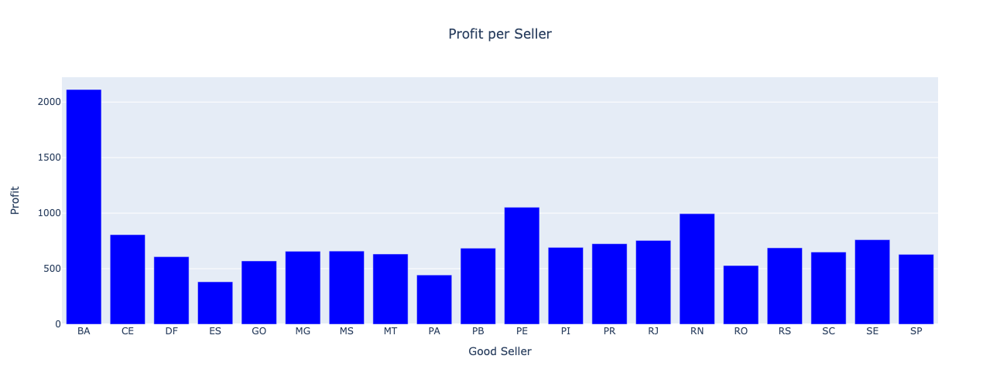

In [161]:
fig = go.Figure(data=go.Bar(x=norm_positive['seller_state'], y=norm_positive['profits'], name="Profit per Seller",
                            marker=dict(color="blue")))
fig.update_layout(legend=dict(yanchor="bottom",y=0.1,xanchor="right",x=0.99), xaxis=dict(title=dict(text="Good Seller")),
                  yaxis=dict(title=dict(text="Profit")), width=1000, height=500, title='Profit per Seller',title_x=0.5)

fig.show()

## 3 - Average Profit by state

In [162]:
sellers.keys()

Index(['seller_id', 'seller_state', 'months_on_olist', 'quantity', 'sales',
       'cost_of_reviews', 'revenues', 'profits', 'Total_Cost', 'Revenue',
       'Global_profit', 'amount_sellers'],
      dtype='object')

In [163]:
from olist.data import Olist
data = Olist().get_data()

In [164]:
data.keys()

dict_keys(['sellers', 'product_category_name_translation', 'orders', 'order_items', 'customers', 'geolocation', 'order_payments', 'order_reviews', 'products'])

In [165]:
from olist.order import Order
orders = Order().get_training_data()

In [166]:
orders.keys()

Index(['delay_vs_expected', 'dim_is_five_star', 'dim_is_one_star',
       'expected_wait_time', 'freight_value', 'number_of_products',
       'number_of_sellers', 'order_id', 'order_status', 'price',
       'review_score', 'wait_time', 'distance_seller_customer'],
      dtype='object')

In [167]:
data['geolocation']

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP
...,...,...,...,...,...
1000158,99950,-28.068639,-52.010705,tapejara,RS
1000159,99900,-27.877125,-52.224882,getulio vargas,RS
1000160,99950,-28.071855,-52.014716,tapejara,RS
1000161,99980,-28.388932,-51.846871,david canabarro,RS


In [168]:
orders_sellers = orders.merge(data['order_items'], how='inner', on='order_id').merge(data['sellers'], how='inner', on='seller_id').merge(data['geolocation'], how='inner', left_on='seller_zip_code_prefix', right_on='geolocation_zip_code_prefix')
orders_sellers.keys()

Index(['delay_vs_expected', 'dim_is_five_star', 'dim_is_one_star',
       'expected_wait_time', 'freight_value_x', 'number_of_products',
       'number_of_sellers', 'order_id', 'order_status', 'price_x',
       'review_score', 'wait_time', 'distance_seller_customer',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price_y', 'freight_value_y', 'seller_zip_code_prefix', 'seller_city',
       'seller_state', 'geolocation_zip_code_prefix', 'geolocation_lat',
       'geolocation_lng', 'geolocation_city', 'geolocation_state'],
      dtype='object')

In [169]:
sellers_geo = orders_sellers.groupby('seller_id', as_index=False).agg(avg_dist_to_cust=('distance_seller_customer', 'mean'), lat=('geolocation_lat', 'mean'), lon=('geolocation_lng', 'mean'))

In [170]:
sellers_geo = sellers_geo.merge(sellers, how='inner', on='seller_id')
sellers_geo

,seller_id,avg_dist_to_cust,lat,lon,seller_state,months_on_olist,quantity,sales,cost_of_reviews,revenues,profits,Total_Cost,Revenue,Global_profit,amount_sellers
0,0015a82c2db000af6aaaf3ae2ecb0532,605.178732,-23.640444,-46.541742,SP,1.0,3,2685.00,100,348.500,248.500,1.004362e+06,1916282.501,911920.951199,1394
1,001cca7ae9ae17fb1caed9dfb1094831,818.952119,-20.278513,-40.411675,ES,17.0,239,25080.03,4750,3868.003,-881.997,1.560304e+06,2394623.039,834318.549923,2862
2,002100f778ceb8431b7a1020ff7ab48f,519.876716,-20.528759,-47.411110,SP,7.0,55,1234.50,1110,683.450,-426.550,1.432625e+06,2310569.018,877944.355129,2810
3,003554e2dce176b5555353e4f3555ac8,938.489608,-16.640574,-49.276483,GO,0.0,1,120.00,0,12.000,12.000,1.200952e+06,2154392.996,953441.301046,2228
4,004c9cd9d87a3c30c522c48c4fc07416,625.806400,-21.757321,-48.829744,SP,15.0,170,19712.71,2660,3171.271,511.271,8.190990e+05,1585312.245,766213.224894,858
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2953,ffc470761de7d0232558ba5e786e57b7,603.009770,-23.464178,-46.539335,SP,6.0,31,1649.01,400,644.901,244.901,1.005808e+06,1919408.703,913601.147322,1403
2954,ffdd9f82b9a447f6f8d4b91554cc7dd3,445.758642,-25.417039,-49.260760,PR,18.0,20,2101.20,240,1650.120,1410.120,3.919668e+05,701663.701,309696.881944,197
2955,ffeee66ac5d5a62fe688b9d26f83f534,715.015888,-20.814772,-49.506928,SP,7.0,14,1839.86,200,743.986,543.986,7.991057e+05,1551948.212,752842.542931,824
2956,fffd5413c0700ac820c7069d66d98c89,580.376898,-22.721605,-46.844150,SP,13.0,61,9062.30,1360,1946.230,586.230,7.773313e+05,1506203.049,728871.713910,771


In [171]:
sellers_geo.keys()

Index(['seller_id', 'avg_dist_to_cust', 'lat', 'lon', 'seller_state',
       'months_on_olist', 'quantity', 'sales', 'cost_of_reviews', 'revenues',
       'profits', 'Total_Cost', 'Revenue', 'Global_profit', 'amount_sellers'],
      dtype='object')

In [172]:
coordinates = sellers_geo[['lat', 'lon', 'profits', 'seller_state']]
coordinates

,lat,lon,profits,seller_state
0,-23.640444,-46.541742,248.500,SP
1,-20.278513,-40.411675,-881.997,ES
2,-20.528759,-47.411110,-426.550,SP
3,-16.640574,-49.276483,12.000,GO
4,-21.757321,-48.829744,511.271,SP
...,...,...,...,...
2953,-23.464178,-46.539335,244.901,SP
2954,-25.417039,-49.260760,1410.120,PR
2955,-20.814772,-49.506928,543.986,SP
2956,-22.721605,-46.844150,586.230,SP


In [173]:
profits_state = coordinates.groupby('seller_state').agg(profit_by_state=('profits', 'mean'))

In [174]:
profits_state

,profit_by_state
seller_state,
AM,-2.300000
BA,1530.522556
CE,460.631167
DF,416.595286
ES,206.521091
GO,324.267205
MA,-3069.105000
MG,401.378803
MS,523.033800


In [178]:
brazil_states = gpd.read_file('data/brazil_map/lim_unidade_federacao_a.shp')

In [179]:
brazil_states.columns

Index(['nome', 'nomeabrev', 'geometriaa', 'sigla', 'geocodigo', 'id_produto',
       'id_element', 'cd_insumo_', 'nr_insumo_', 'nr_insum_1', 'tx_insumo_',
       'geometry'],
      dtype='object')

In [180]:
brazil_states = brazil_states[['nome','sigla','geometry']]
brazil_states

,nome,sigla,geometry
0,Minas Gerais,MG,"POLYGON ((-44.21152 -14.22955, -44.20750 -14.2..."
1,Rio Grande do Sul,RS,"POLYGON ((-53.03425 -27.15455, -53.03079 -27.1..."
2,Mato Grosso do Sul,MS,"POLYGON ((-56.09815 -17.17220, -56.09159 -17.1..."
3,Alagoas,AL,"POLYGON ((-35.45878 -8.81780, -35.45898 -8.824..."
4,Sergipe,SE,"POLYGON ((-38.00366 -9.51544, -38.00052 -9.519..."
5,Tocantins,TO,"POLYGON ((-48.34644 -5.17871, -48.34311 -5.181..."
6,Amazonas,AM,"POLYGON ((-67.32285 2.04176, -67.29220 1.91093..."
7,Roraima,RR,"POLYGON ((-60.17793 5.23024, -60.16619 5.22895..."
8,Acre,AC,"POLYGON ((-73.73811 -7.13471, -72.90246 -7.436..."
9,Rondônia,RO,"POLYGON ((-62.79892 -8.02312, -62.78622 -8.028..."


In [181]:
brazil_states.rename({"sigla": 'seller_state'}, axis=1, inplace=True)

In [182]:
brazil_profit = brazil_states.merge(profits_state, on='seller_state', how='left')
brazil_profit = brazil_profit[['seller_state', 'profit_by_state', 'geometry']]
brazil_profit['center_x'] = brazil_profit['geometry'].map(lambda c: c.centroid.x)
brazil_profit['center_y'] = brazil_profit['geometry'].map(lambda c: c.centroid.y)

In [183]:
brazil_geojson = brazil_profit.to_crs(epsg=4326).__geo_interface__

In [184]:
brazil_profit

,seller_state,profit_by_state,geometry,center_x,center_y
0,MG,401.378803,"POLYGON ((-44.21152 -14.22955, -44.20750 -14.2...",-44.673885,-18.453221
1,RS,451.926484,"POLYGON ((-53.03425 -27.15455, -53.03079 -27.1...",-53.246243,-29.787576
2,MS,523.033800,"POLYGON ((-56.09815 -17.17220, -56.09159 -17.1...",-54.846299,-20.324694
3,AL,NaN,"POLYGON ((-35.45878 -8.81780, -35.45898 -8.824...",-36.624018,-9.515321
4,SE,760.310000,"POLYGON ((-38.00366 -9.51544, -38.00052 -9.519...",-37.446401,-10.581309
5,TO,NaN,"POLYGON ((-48.34644 -5.17871, -48.34311 -5.181...",-48.329651,-10.146228
6,AM,-2.300000,"POLYGON ((-67.32285 2.04176, -67.29220 1.91093...",-64.656074,-4.151911
7,RR,NaN,"POLYGON ((-60.17793 5.23024, -60.16619 5.22895...",-61.394070,2.087070
8,AC,NaN,"POLYGON ((-73.73811 -7.13471, -72.90246 -7.436...",-70.479441,-9.210372
9,RO,528.110000,"POLYGON ((-62.79892 -8.02312, -62.78622 -8.028...",-62.841633,-10.910123


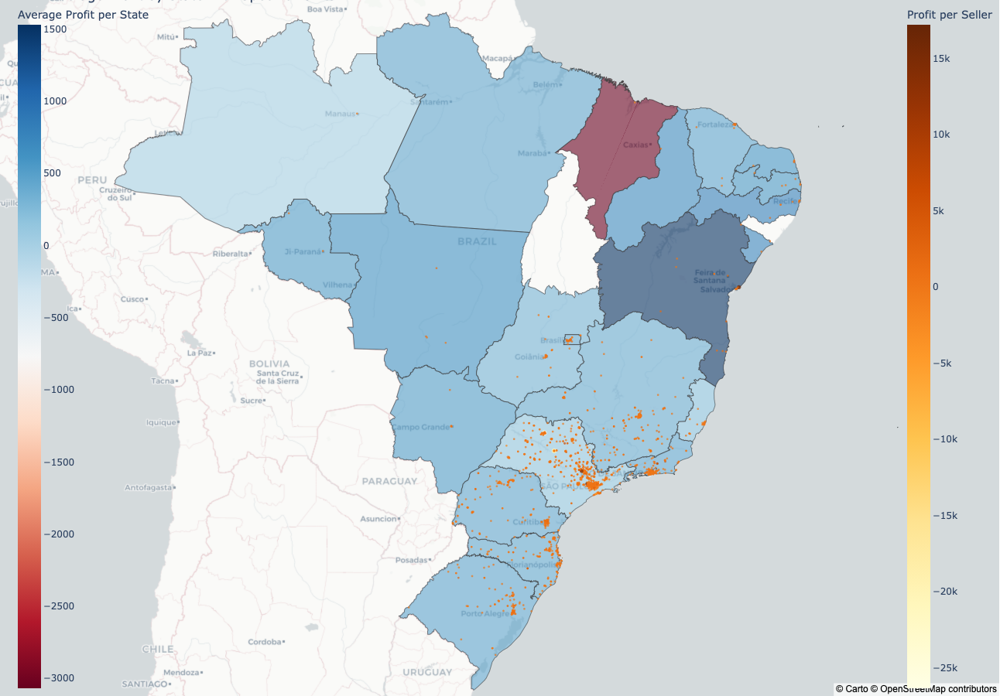

In [186]:
fig = px.choropleth_mapbox(
    brazil_profit,
    geojson=brazil_geojson,
    locations='seller_state',
    featureidkey="properties.seller_state",
    color='profit_by_state',
    color_continuous_scale="RdBu",
    opacity=0.6,
    labels={'profit_by_state': 'Average Profit per State'}
)

# Add scatter points from the coordinates DataFrame
fig.add_trace(go.Scattermapbox(
    lon=coordinates['lon'],
    lat=coordinates['lat'],
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=coordinates['profits'].apply(lambda x: max(abs(x) / 1000, 5)),  # Scale and set a minimum size
        color=coordinates['profits'],  # Color based on profits
        colorscale='YlOrBr',  # Color scale for the coordinates data
        showscale=True,
        sizemode='area',
        colorbar=dict(
            title="Profit per Seller", 
            x=0.9,  # Position the colorbar on the right
            xanchor='left'
        )
    ),
    text=coordinates.apply(lambda row: f"Profit per Seller: {row['profits']:,} BRL", axis=1),
    hoverinfo='text',
    name='Profit Dots'
))

# Update layout for the base map's color scale
fig.update_layout(
    title_text="Average Profit by State with Specific Points",
    mapbox_style="carto-positron",
    mapbox_zoom=4,
    mapbox_center={"lat": -16.2350, "lon": -51.9253},
    margin={"r":0,"t":0,"l":0,"b":0},
    coloraxis_colorbar=dict(
        title="Average Profit per State",  # Title for the base map color scale
        x=0.01,  # Position the color scale on the left
        xanchor='left'
    ),
    showlegend=False,
    width=1300,
    height=900
)

# Show the plot
fig.show()

### Takeaways

- Good Sellers: Keep them because they are having a good performance.
- Median Sellers: Sit down with Median Sellers to understand their needs in other to increase the profit.
- Bad Sellers: Put them in a training system so they can perform better, but if they don't improve it might be best to remove them from the Olist platform.
- Invest in propaganda on MG, PR, RJ, RS, SC states: These states have a potential to increase their sales due their customers demands